In [ ]:
# !pip install lime
!pip install catboost lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 4.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.2/99.2 MB 7.5 MB/s eta 0:00:00
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=3b2403021b7b49e81f26d902d4fcb8ee8238100122ff40a80426cc9305213c06
  Stored in directory: /root/.cache/pip/wheels/e7/5d/0e/4b4fff9a47468fed5633211fb3b76d1db43fe806a17fb7486a
Successfully built lime


# Import Library

In [ ]:
from sklearn.feature_selection import mutual_info_classif
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, make_scorer, ConfusionMatrixDisplay

from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.model_selection import train_test_split, GridSearchCV

from sklearn.ensemble import StackingClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier

import lime
from lime import lime_tabular
from lime.lime_text import LimeTextExplainer
from lime.lime_tabular import LimeTabularExplainer

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
from scipy.stats import gaussian_kde

import warnings
import re
import string
import joblib
import math
import time

**Merge Dataset**

In [ ]:
import pandas as pd

print("Loading exam_results ...")
exam_results = pd.read_excel("exam_results.xlsx")

print("Loading exam_registrations ...")
exam_regs = pd.read_excel("exam_registrations.xlsx")

# ========== MERGE 1 ==========
print("Merging exam_results + exam_registrations ...")
df_big = exam_results.merge(
    exam_regs,
    left_on="exam_registration_id",
    right_on="id",
    how="left",
    suffixes=("_examres", "_examreg")
)

del exam_results, exam_regs


# ===============================
# LOAD TRACKINGS (only needed columns)
# ===============================
print("Loading trackings (selected columns only) ...")
track = pd.read_excel(
    "developer_journey_trackings.xlsx",
    usecols=["developer_id", "journey_id", "tutorial_id", "status", "completed_at", "last_viewed"]
)

# ========== MERGE 2 ==========
print("Merging df_big + trackings ...")
df_big = df_big.merge(
    track,
    left_on="examinees_id",
    right_on="developer_id",
    how="left"
)

del track


# ===============================
# LOAD SUBMISSIONS (selected columns)
# ===============================
print("Loading submissions (selected columns only) ...")
subs = pd.read_excel(
    "developer_journey_submissions.xlsx",
    usecols=[
        "submitter_id", "journey_id", "rating",
        "submission_duration", "status", "quiz_id"
    ]
)

# ========== MERGE 3 ==========
print("Merging df_big + submissions ...")
df_big = df_big.merge(
    subs,
    left_on="examinees_id",
    right_on="submitter_id",
    how="left",
    suffixes=("", "_sub")
)

del subs


# ===============================
# LOAD COMPLETIONS
# ===============================
print("Loading completions ...")
comp = pd.read_excel(
    "developer_journey_completions.xlsx",
    usecols=[
        "user_id", "journey_id", "study_duration",
        "avg_submission_rating", "enrolling_times"
    ]
)

# ========== MERGE 4 ==========
print("Merging df_big + completions ...")
df_big = df_big.merge(
    comp,
    left_on="examinees_id",
    right_on="user_id",
    how="left",
    suffixes=("", "_comp")
)

del comp


# ===============================
# DONE
# ===============================
print("DONE! Final shape:", df_big.shape)
df_big.head()


Loading exam_results ...
Loading exam_registrations ...
Merging exam_results + exam_registrations ...
Loading trackings (selected columns only) ...
Merging df_big + trackings ...


In [ ]:
df_big.to_csv("df_big.csv", index=False)
df_big.to_excel("df_big.xlsx", index=False)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Clustering

In [ ]:
!pip install scikit-learn-extra

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 819.0/819.0 kB 16.3 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for scikit-learn-extra: filename=scikit_learn_extra-0.3.0-cp312-cp312-linux_x86_64.whl size=1963612 sha256=0c93dddb7470f5d399030f52a356964e0363eac45f4f9c9e5e709b242079d0b1
  Stored in directory: /root/.cache/pip/wheels/17/4d/c3/c6d5d563c1bf8146d059d63be3678abc2f2801fba0aaf5f0b8
Successfully built scikit-learn-extra


In [ ]:
from scipy.stats import mode
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
# from sklearn_extra.cluster import KMedoids
from sklearn.preprocessing import LabelEncoder, StandardScaler, MinMaxScaler
from sklearn.metrics import silhouette_score, DistanceMetric, davies_bouldin_score
import hdbscan

from math import pi
from scipy.cluster.hierarchy import dendrogram, linkage
from collections.abc import Iterable
from yellowbrick.cluster import KElbowVisualizer
from sklearn.decomposition import PCA

import matplotlib.colors as mcolors
import scipy.sparse as sp


In [ ]:
df_merged = pd.read_csv("df_big_clean.csv")
df_merged.head()

/tmp/ipython-input-1239332106.py:1: DtypeWarning: Columns (25) have mixed types. Specify dtype option on import or set low_memory=False.
  df_merged = pd.read_csv("df_big_clean.csv")


,journey_id,tutorial_id,user_id,tracking_status,tracking_last_viewed,tracking_first_opened_at,tracking_completed_at,completion_created_at,completion_enrolling_times,completion_study_duration,...,exam_registration_id,exam_created_at,exam_retake_limit_at,exam_finished_at,exam_deleted_at,exam_total_questions,exam_score,exam_is_passed,exam_result_created_at,exam_look_report_at
0,26,599,96989,1,2017-05-26 21:34:02,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,26,602,96989,0,2017-05-26 21:35:05,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,32,1152,96989,1,2020-04-08 20:59:59,2018-08-29 11:19:41,NaN,2020-04-11 14:39:11,3.0,44.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,32,1152,96989,1,2020-04-08 20:59:59,2018-08-29 11:19:41,NaN,2020-04-11 14:39:11,3.0,44.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,32,719,96989,1,2020-04-08 21:00:14,2018-08-29 11:32:44,NaN,2020-04-11 14:39:11,3.0,44.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df_merged.shape # df_merged

(318011, 26)

In [ ]:
# kemungkinan yang akan di pakai dan hapus exam

# - tracking_status
# - tracking_first_opened_at
# - tracking_completed_at
# - completion_created_at
# - completion_enrolling_times
# - completion_study_duration
# - completion_avg_submission_rating
# - submission_status
# - submission_created_at
# - submission_ended_review_at
# - submission_duration
# - submission_rating
# - exam_total_questions
# - exam_score
# - exam_is_passed
# - exam_finished_at

df_merged.columns

Index(['journey_id', 'tutorial_id', 'user_id', 'tracking_status',
       'tracking_last_viewed', 'tracking_first_opened_at',
       'tracking_completed_at', 'completion_created_at',
       'completion_enrolling_times', 'completion_study_duration',
       'completion_avg_submission_rating', 'submission_status',
       'submission_created_at', 'submission_ended_review_at',
       'submission_rating', 'submission_duration', 'exam_registration_id',
       'exam_created_at', 'exam_retake_limit_at', 'exam_finished_at',
       'exam_deleted_at', 'exam_total_questions', 'exam_score',
       'exam_is_passed', 'exam_result_created_at', 'exam_look_report_at'],
      dtype='object')

In [ ]:
cols = [
    "tracking_status",
    "tracking_first_opened_at",
    "tracking_completed_at",
    "completion_created_at",
    "completion_enrolling_times",
    "completion_study_duration",
    "completion_avg_submission_rating",
    "submission_status",
    "submission_created_at",
    "submission_duration",
    "submission_ended_review_at",
    "submission_rating",
]

In [ ]:
df_merged = df_merged[cols].copy()

In [ ]:
df_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 318011 entries, 0 to 318010
Data columns (total 12 columns):
 #   Column                            Non-Null Count   Dtype  
---  ------                            --------------   -----  
 0   tracking_status                   318011 non-null  int64  
 1   tracking_first_opened_at          242262 non-null  object 
 2   tracking_completed_at             269214 non-null  object 
 3   completion_created_at             284280 non-null  object 
 4   completion_enrolling_times        284280 non-null  float64
 5   completion_study_duration         284280 non-null  float64
 6   completion_avg_submission_rating  244413 non-null  float64
 7   submission_status                 259973 non-null  float64
 8   submission_created_at             259973 non-null  object 
 9   submission_duration               259973 non-null  float64
 10  submission_ended_review_at        246556 non-null  object 
 11  submission_rating                 259973 non-null  f

In [ ]:
X = df_merged.sample(frac=1, random_state=42).reset_index(drop=True)

In [ ]:
datetime_cols = [
    "tracking_first_opened_at",
    "tracking_completed_at",
    "completion_created_at",
    "submission_created_at",
    "submission_ended_review_at",
    # "exam_finished_at"
]

for col in datetime_cols:
    X[col] = pd.to_datetime(X[col], errors="coerce").astype("int64") // 10**9
    # hasil: detik sejak 1970 (unix timestamp)

In [ ]:
# categorical_cols = ["tracking_status", "submission_status"]

# encoder = LabelEncoder()
# for col in categorical_cols:
#     X[col] = encoder.fit_transform(X[col].astype(str))

In [ ]:
# X["exam_is_passed"] = X["exam_is_passed"].astype(int)

In [ ]:
# submission_rating, tracking_status, submission_status, jangan di normalisasi
exclude_cols = ["submission_rating", "tracking_status", "submission_status"]

X_to_scale = X.drop(columns=exclude_cols)
X_not_scaled = X[exclude_cols]

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_to_scale)

X_scaled_df = pd.DataFrame(X_scaled, columns=X_to_scale.columns)
X_final = pd.concat([X_scaled_df, X_not_scaled], axis=1)
X_final = X_final[X.columns]

X = X_final
X.head()

,tracking_status,tracking_first_opened_at,tracking_completed_at,completion_created_at,completion_enrolling_times,completion_study_duration,completion_avg_submission_rating,submission_status,submission_created_at,submission_duration,submission_ended_review_at,submission_rating
0,1,-1.788280,0.411015,0.311379,-0.558108,-0.390032,0.973470,1.0,0.443253,-0.267624,0.511230,4.0
1,1,-1.788280,-2.348728,0.314923,0.946753,-0.364434,-1.906280,-1.0,0.446573,-0.267624,0.514300,0.0
2,1,-1.788280,0.413766,-2.902740,NaN,NaN,NaN,NaN,-2.116306,NaN,-1.857450,NaN
3,1,0.563962,0.428489,0.354961,-0.558108,-0.381499,-0.108126,-1.0,0.478115,0.520625,0.543482,0.0
4,1,0.567185,0.432295,0.361274,0.946753,-0.253511,-1.460121,1.0,0.483588,-0.261940,0.548558,3.0


In [ ]:
print(f"X Shape {X.shape}")
print(f"Full Features {df_merged.shape}")

X Shape (318011, 12)
Full Features (318011, 12)


In [ ]:
X.isna().sum()

,0
tracking_status,0
tracking_first_opened_at,0
tracking_completed_at,0
completion_created_at,0
completion_enrolling_times,33731
completion_study_duration,33731
completion_avg_submission_rating,73598
submission_status,58038
submission_created_at,0
submission_duration,58038


In [ ]:
X.duplicated().sum()

np.int64(62408)

In [ ]:
X = X.dropna()
X = X.drop_duplicates()

In [ ]:
print(f"X Shape {X.shape}")
print(f"Full Features {df_merged.shape}")

X Shape (201770, 12)
Full Features (318011, 12)


In [ ]:
km = KMeans(random_state=42)
visualizer = KElbowVisualizer(km, k=(1,10))

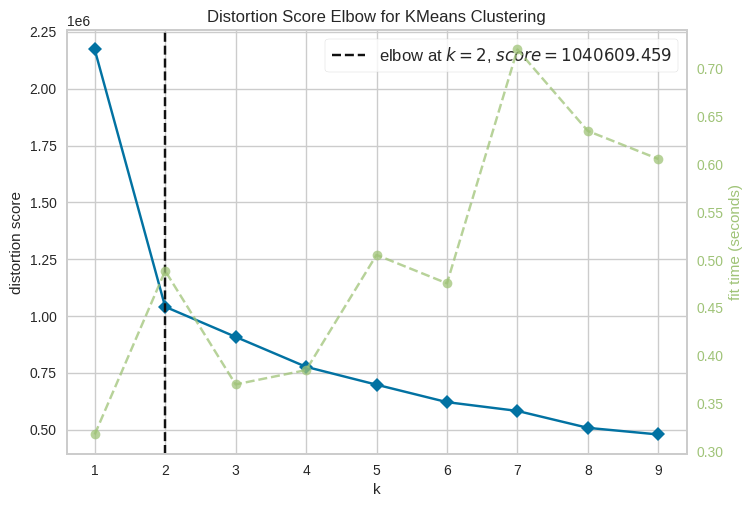

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [ ]:
visualizer.fit(X)
visualizer.show()

In [ ]:
visualizer.elbow_value_

np.int64(2)

In [ ]:
X.shape

(201770, 12)

In [ ]:
optimal_k = 3

kmeans = KMeans(n_clusters=optimal_k, random_state=42)
labels = kmeans.fit_predict(X)
centroids = kmeans.cluster_centers_

X['label'] = labels

# clusterer = hdbscan.HDBSCAN(
#     min_cluster_size=100,     # bisa Anda tweak
#     min_samples=50,
#     metric='euclidean'
# )

# labels = clusterer.fit_predict(X)

# # HDBSCAN tidak punya centroids → opsional
# centroids = None

# X['label'] = labels

# gmm = GaussianMixture(n_components=3, covariance_type='full', n_init=20, random_state=42) # n 3 karena tujuan label

# labels = gmm.fit_predict(X)
# centroids = gmm.means_

# X['label'] = labels

In [ ]:
print(f"Jumlah iterasi yang digunakan: {kmeans.n_iter_}")
print(f"Jumlah Centroid : {centroids.shape}")

Jumlah iterasi yang digunakan: 4
Jumlah Centroid : (3, 12)


In [ ]:
# cluster_profile = X.groupby("label").agg({
#     "completion_study_duration": "mean",
#     "completion_avg_submission_rating": "mean",
#     "submission_duration": "mean",
#     "submission_rating": "mean",
# }).reset_index()

# cluster_profile["score"] = (
#     cluster_profile["submission_rating"] * 0.5 +
#     cluster_profile["completion_avg_submission_rating"] * 0.3 -
#     cluster_profile["completion_study_duration"] * 0.1 -
#     cluster_profile["submission_duration"] * 0.1
# )

# cluster_profile = cluster_profile.sort_values("score", ascending=False)
# cluster_profile["rank"] = range(1, len(cluster_profile) + 1)

# label_map = {}
# for _, row in cluster_profile.iterrows():
#     cl = row["label"]
#     r = row["rank"]

#     if r <= 2:
#         label_map[cl] = "Si Jago"
#     elif r <= 4:
#         label_map[cl] = "Si Ragu-Ragu"
#     else:
#         label_map[cl] = "Si Beresiko"

# X["label_cluster"] = X["label"].map(label_map)

In [ ]:
X_pca_data = X.drop(columns=["label"]).copy()

In [ ]:
use_centroid = centroids is not None and len(centroids) > 0

pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_pca_data)

unique_clusters = np.unique(X["label"])

if use_centroid:
    centroids_pca = pca.transform(centroids)
else:
    centroids_pca = np.array([])

pca_df = pd.DataFrame({
    'PC1': X_pca[:, 0],
    'PC2': X_pca[:, 1],
    'Cluster': X["label"].astype(str)
})

explained_var = pca.explained_variance_ratio_
pc1_var = explained_var[0] * 100
pc2_var = explained_var[1] * 100

colors = px.colors.qualitative.Set3[:len(unique_clusters)]
if len(unique_clusters) > len(colors):
    colors = px.colors.sample_colorscale("Turbo", [
        n/(len(unique_clusters)-1) for n in range(len(unique_clusters))
    ])

fig = go.Figure()

for idx, cluster in enumerate(unique_clusters):
    cluster_data = pca_df[pca_df['Cluster'] == str(cluster)]

    fig.add_trace(go.Scatter(
        x=cluster_data['PC1'],
        y=cluster_data['PC2'],
        mode='markers',
        name=f'Cluster {cluster}',
        marker=dict(
            size=8,
            color=colors[idx],
            opacity=0.65,
            line=dict(width=0.5, color='white'),
            symbol='circle'
        ),
        hovertemplate='<b>Cluster ' + str(cluster) + '</b><br>' +
                      'PC1: %{x:.3f}<br>' +
                      'PC2: %{y:.3f}<br>' +
                      '<extra></extra>'
    ))

if use_centroid:
    fig.add_trace(go.Scatter(
        x=centroids_pca[:, 0],
        y=centroids_pca[:, 1],
        mode='markers',
        name='Centroids',
        marker=dict(
            size=20,
            color='#2C3E50',
            symbol='x',
            line=dict(width=3, color='white'),
            opacity=1
        ),
        hovertemplate='<b>Centroid</b><br>' +
                      'PC1: %{x:.3f}<br>' +
                      'PC2: %{y:.3f}<br>' +
                      '<extra></extra>'
    ))

    for i, (cx, cy) in enumerate(centroids_pca):
        fig.add_shape(
            type="circle",
            xref="x", yref="y",
            x0=cx-0.5, y0=cy-0.5,
            x1=cx+0.5, y1=cy+0.5,
            line=dict(color="rgba(44, 62, 80, 0.4)", width=2, dash="dash"),
        )

fig.update_layout(
    title={
        'text': f'PCA Visualization of Clustering<br><sub>PC1: {pc1_var:.2f}% | PC2: {pc2_var:.2f}% | Total: {pc1_var+pc2_var:.2f}%</sub>',
        'x': 0.5,
        'xanchor': 'center',
        'font': {'size': 24, 'color': '#2C3E50'}
    },
    xaxis=dict(
        title=f'PC1 ({pc1_var:.2f}% variance)',
        titlefont=dict(size=14, color='#34495E'),
        gridcolor='rgba(200, 200, 200, 0.3)',
        showgrid=True,
        zeroline=True,
        zerolinewidth=2,
        zerolinecolor='rgba(0, 0, 0, 0.2)',
        showline=True,
        linewidth=2,
        linecolor='rgba(0, 0, 0, 0.3)'
    ),
    yaxis=dict(
        title=f'PC2 ({pc2_var:.2f}% variance)',
        titlefont=dict(size=14, color='#34495E'),
        gridcolor='rgba(200, 200, 200, 0.3)',
        showgrid=True,
        zeroline=True,
        zerolinewidth=2,
        zerolinecolor='rgba(0, 0, 0, 0.2)',
        showline=True,
        linewidth=2,
        linecolor='rgba(0, 0, 0, 0.3)'
    ),
    plot_bgcolor='rgba(250, 250, 250, 1)',
    paper_bgcolor='white',
    hovermode='closest',
    height=800,
    width=1200,
    legend=dict(
        title=dict(text='<b>Clusters</b>', font=dict(size=13)),
        orientation="v",
        yanchor="top",
        y=0.99,
        xanchor="right",
        x=0.99,
        bgcolor="rgba(255, 255, 255, 0.95)",
        bordercolor="rgba(0, 0, 0, 0.3)",
        borderwidth=2,
        font=dict(size=11)
    ),
)

if use_centroid:
    annotations = []
    for i, (cx, cy) in enumerate(centroids_pca):
        annotations.append(dict(
            x=cx,
            y=cy,
            text=f"C{i}",
            showarrow=True,
            arrowhead=2,
            arrowsize=1,
            arrowwidth=2,
            arrowcolor="#E74C3C",
            ax=30,
            ay=-30,
            font=dict(size=12, color="#E74C3C"),
            bgcolor="rgba(255, 255, 255, 0.9)",
            bordercolor="#E74C3C",
            borderwidth=2,
            borderpad=4
        ))

    fig.update_layout(annotations=annotations)

fig.show()


/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but PCA was fitted with feature names
  warnings.warn(


In [ ]:
fig2 = go.Figure()

for idx, cluster in enumerate(unique_clusters):
    cluster_data = pca_df[pca_df['Cluster'] == str(cluster)]

    if len(cluster_data) > 5:
        fig2.add_trace(go.Scatter(
            x=cluster_data['PC1'],
            y=cluster_data['PC2'],
            mode='markers',
            name=f'Cluster {cluster}',
            marker=dict(
                size=6,
                color=colors[idx],
                opacity=0.5,
                line=dict(width=0.5, color='white')
            ),
            showlegend=True,
            hovertemplate='<b>Cluster ' + str(cluster) + '</b><br>' +
                          'PC1: %{x:.3f}<br>PC2: %{y:.3f}<extra></extra>'
        ))

        try:
            kde = gaussian_kde(cluster_data[['PC1', 'PC2']].T.values)

            x_min, x_max = cluster_data['PC1'].min(), cluster_data['PC1'].max()
            y_min, y_max = cluster_data['PC2'].min(), cluster_data['PC2'].max()

            x_range = x_max - x_min
            y_range = y_max - y_min
            x_min, x_max = x_min - 0.2*x_range, x_max + 0.2*x_range
            y_min, y_max = y_min - 0.2*y_range, y_max + 0.2*y_range

            xx, yy = np.mgrid[x_min:x_max:50j, y_min:y_max:50j]
            positions = np.vstack([xx.ravel(), yy.ravel()])
            density = kde(positions).reshape(xx.shape)

            fig2.add_trace(go.Contour(
                x=xx[:, 0],
                y=yy[0, :],
                z=density,
                showscale=False,
                colorscale=[[0, f'rgba{tuple(list(px.colors.hex_to_rgb(colors[idx])) + [0])}'],
                           [1, f'rgba{tuple(list(px.colors.hex_to_rgb(colors[idx])) + [0.3])}']],
                line=dict(width=1, color=colors[idx]),
                name=f'Density C{cluster}',
                showlegend=False,
                hoverinfo='skip'
            ))
        except:
            pass

fig2.add_trace(go.Scatter(
    x=centroids_pca[:, 0],
    y=centroids_pca[:, 1],
    mode='markers+text',
    name='Centroids',
    text=[f'C{i}' for i in range(len(centroids_pca))],
    textposition='top center',
    textfont=dict(size=12, color='white', family='Arial Black'),
    marker=dict(
        size=22,
        color='#2C3E50',
        symbol='x',
        line=dict(width=3, color='white')
    ),
    hovertemplate='<b>Centroid %{text}</b><br>PC1: %{x:.3f}<br>PC2: %{y:.3f}<extra></extra>'
))

fig2.update_layout(
    title={
        'text': f'PCA Clustering with Density Contours<br><sub>Kontur menunjukkan kepadatan data per cluster</sub>',
        'x': 0.5,
        'xanchor': 'center',
        'font': {'size': 24, 'color': '#2C3E50', 'family': 'Arial Black'}
    },
    xaxis=dict(
        title=f'PC1 ({pc1_var:.2f}% variance)',
        gridcolor='rgba(200, 200, 200, 0.3)',
        zeroline=True,
        zerolinewidth=2,
        zerolinecolor='rgba(0, 0, 0, 0.2)'
    ),
    yaxis=dict(
        title=f'PC2 ({pc2_var:.2f}% variance)',
        gridcolor='rgba(200, 200, 200, 0.3)',
        zeroline=True,
        zerolinewidth=2,
        zerolinecolor='rgba(0, 0, 0, 0.2)'
    ),
    plot_bgcolor='rgba(250, 250, 250, 1)',
    paper_bgcolor='white',
    height=800,
    width=1200,
    hovermode='closest',
    legend=dict(
        orientation="v",
        yanchor="top",
        y=0.99,
        xanchor="right",
        x=0.99,
        bgcolor="rgba(255, 255, 255, 0.95)",
        bordercolor="rgba(0, 0, 0, 0.3)",
        borderwidth=2
    )
)

fig2.show()

In [ ]:
centroid_scores = []
for i, c in enumerate(centroids_pca):
    score = c[0] * 0.7 + c[1] * 0.3
    centroid_scores.append((i, score))

centroid_scores_sorted = sorted(centroid_scores, key=lambda x: x[1], reverse=True)

cluster_names = ["Si Jago", "Si Ragu-Ragu", "Si Beresiko"]

label_map = {}
for rank, (cluster_id, score) in enumerate(centroid_scores_sorted):
    label_map[cluster_id] = cluster_names[rank]

X["label_cluster"] = X["label"].map(label_map)

In [ ]:
df_merged.head()

,tracking_status,tracking_first_opened_at,tracking_completed_at,completion_created_at,completion_enrolling_times,completion_study_duration,completion_avg_submission_rating,submission_status,submission_created_at,submission_duration,submission_ended_review_at,submission_rating
0,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1,2018-08-29 11:19:41,NaN,2020-04-11 14:39:11,3.0,44.0,4.5,1.0,2018-09-02 17:26:18,0.0,2018-09-02 22:20:01,4.0
3,1,2018-08-29 11:19:41,NaN,2020-04-11 14:39:11,3.0,44.0,4.5,1.0,2020-04-11 13:57:00,0.0,2020-04-11 14:39:11,5.0
4,1,2018-08-29 11:32:44,NaN,2020-04-11 14:39:11,3.0,44.0,4.5,1.0,2018-09-02 17:26:18,0.0,2018-09-02 22:20:01,4.0


In [ ]:
X

,tracking_status,tracking_first_opened_at,tracking_completed_at,completion_created_at,completion_enrolling_times,completion_study_duration,completion_avg_submission_rating,submission_status,submission_created_at,submission_duration,submission_ended_review_at,submission_rating,label,label_cluster
0,1,-1.788280,0.411015,0.311379,-0.558108,-0.390032,0.973470,1.0,0.443253,-0.267624,0.511230,4.0,1,Si Jago
1,1,-1.788280,-2.348728,0.314923,0.946753,-0.364434,-1.906280,-1.0,0.446573,-0.267624,0.514300,0.0,0,Si Beresiko
3,1,0.563962,0.428489,0.354961,-0.558108,-0.381499,-0.108126,-1.0,0.478115,0.520625,0.543482,0.0,0,Si Beresiko
4,1,0.567185,0.432295,0.361274,0.946753,-0.253511,-1.460121,1.0,0.483588,-0.261940,0.548558,3.0,1,Si Jago
5,1,0.554827,0.417704,0.343057,-0.558108,-0.372967,-1.460121,-2.0,0.469057,-0.199410,-1.857450,0.0,0,Si Beresiko
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
318004,1,0.560198,0.424045,0.330322,0.946753,-0.411363,1.243870,1.0,0.477311,-0.222148,0.542737,4.0,1,Si Jago
318005,1,0.554460,0.418170,0.342528,-0.558108,-0.138321,-1.906280,-1.0,0.467621,0.823798,0.533778,0.0,0,Si Beresiko
318007,0,0.571123,-2.348728,0.362579,0.946753,-0.116990,-0.648924,-1.0,0.482588,-0.254740,0.547622,0.0,0,Si Beresiko
318008,1,-1.788280,0.438646,0.333898,0.946753,-0.432695,-0.108126,-1.0,0.461774,-0.244886,0.528360,0.0,0,Si Beresiko


In [ ]:
X.iloc[:, :-1]


,tracking_status,tracking_first_opened_at,tracking_completed_at,completion_created_at,completion_enrolling_times,completion_study_duration,completion_avg_submission_rating,submission_status,submission_created_at,submission_duration,submission_ended_review_at,submission_rating,label
0,1,-1.788280,0.411015,0.311379,-0.558108,-0.390032,0.973470,1.0,0.443253,-0.267624,0.511230,4.0,1
1,1,-1.788280,-2.348728,0.314923,0.946753,-0.364434,-1.906280,-1.0,0.446573,-0.267624,0.514300,0.0,0
3,1,0.563962,0.428489,0.354961,-0.558108,-0.381499,-0.108126,-1.0,0.478115,0.520625,0.543482,0.0,0
4,1,0.567185,0.432295,0.361274,0.946753,-0.253511,-1.460121,1.0,0.483588,-0.261940,0.548558,3.0,1
5,1,0.554827,0.417704,0.343057,-0.558108,-0.372967,-1.460121,-2.0,0.469057,-0.199410,-1.857450,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
318004,1,0.560198,0.424045,0.330322,0.946753,-0.411363,1.243870,1.0,0.477311,-0.222148,0.542737,4.0,1
318005,1,0.554460,0.418170,0.342528,-0.558108,-0.138321,-1.906280,-1.0,0.467621,0.823798,0.533778,0.0,0
318007,0,0.571123,-2.348728,0.362579,0.946753,-0.116990,-0.648924,-1.0,0.482588,-0.254740,0.547622,0.0,0
318008,1,-1.788280,0.438646,0.333898,0.946753,-0.432695,-0.108126,-1.0,0.461774,-0.244886,0.528360,0.0,0


In [ ]:
def evaluate_clustering(X, labels, centers=None):
    valid_mask = labels != -1
    X_valid = X[valid_mask]
    labels_valid = labels[valid_mask]

    if centers is not None:
        sse = np.sum((X.values - centers[labels]) ** 2)
    else:
        sse = None

    sil = silhouette_score(X_valid, labels_valid) if len(np.unique(labels_valid)) > 1 else None
    dbi = davies_bouldin_score(X_valid, labels_valid) if len(np.unique(labels_valid)) > 1 else None

    print("======= CLUSTERING METRICS =======")
    print(f"SSE: {sse}")
    print(f"Silhouette: {sil}")
    print(f"Davies-Bouldin: {dbi}")
    print("=================================\n")

    return sse, sil, dbi


In [ ]:
X.iloc[:, :-1]

,tracking_status,tracking_first_opened_at,tracking_completed_at,completion_created_at,completion_enrolling_times,completion_study_duration,completion_avg_submission_rating,submission_status,submission_created_at,submission_duration,submission_ended_review_at,submission_rating,label
0,1,-1.788280,0.411015,0.311379,-0.558108,-0.390032,0.973470,1.0,0.443253,-0.267624,0.511230,4.0,1
1,1,-1.788280,-2.348728,0.314923,0.946753,-0.364434,-1.906280,-1.0,0.446573,-0.267624,0.514300,0.0,0
3,1,0.563962,0.428489,0.354961,-0.558108,-0.381499,-0.108126,-1.0,0.478115,0.520625,0.543482,0.0,0
4,1,0.567185,0.432295,0.361274,0.946753,-0.253511,-1.460121,1.0,0.483588,-0.261940,0.548558,3.0,1
5,1,0.554827,0.417704,0.343057,-0.558108,-0.372967,-1.460121,-2.0,0.469057,-0.199410,-1.857450,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
318004,1,0.560198,0.424045,0.330322,0.946753,-0.411363,1.243870,1.0,0.477311,-0.222148,0.542737,4.0,1
318005,1,0.554460,0.418170,0.342528,-0.558108,-0.138321,-1.906280,-1.0,0.467621,0.823798,0.533778,0.0,0
318007,0,0.571123,-2.348728,0.362579,0.946753,-0.116990,-0.648924,-1.0,0.482588,-0.254740,0.547622,0.0,0
318008,1,-1.788280,0.438646,0.333898,0.946753,-0.432695,-0.108126,-1.0,0.461774,-0.244886,0.528360,0.0,0


In [ ]:
evaluate_clustering(X.iloc[:, :-2], labels, centroids) # Kmeans dan GMM
# evaluate_clustering(X.iloc[:, :-1], labels, centers=None) # HDBSCAN VERSION

======= CLUSTERING METRICS =======
SSE: 908085.3838112392
Silhouette: 0.4413386447333377
Davies-Bouldin: 1.01996327258773



(np.float64(908085.3838112392),
 np.float64(0.4413386447333377),
 np.float64(1.01996327258773))

In [ ]:
encoder_label = LabelEncoder()
X["label_cluster_encoding"] = encoder_label.fit_transform(X["label_cluster"].astype(str))

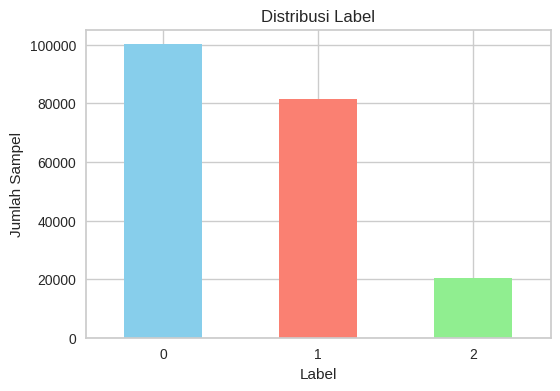

In [ ]:
plt.figure(figsize=(6, 4))
X['label_cluster_encoding'].value_counts().plot(kind='bar', color=['skyblue', 'salmon', 'lightgreen', 'gold'])
plt.title('Distribusi Label')
plt.xlabel('Label')
plt.ylabel('Jumlah Sampel')
plt.xticks(rotation=0)
plt.show()

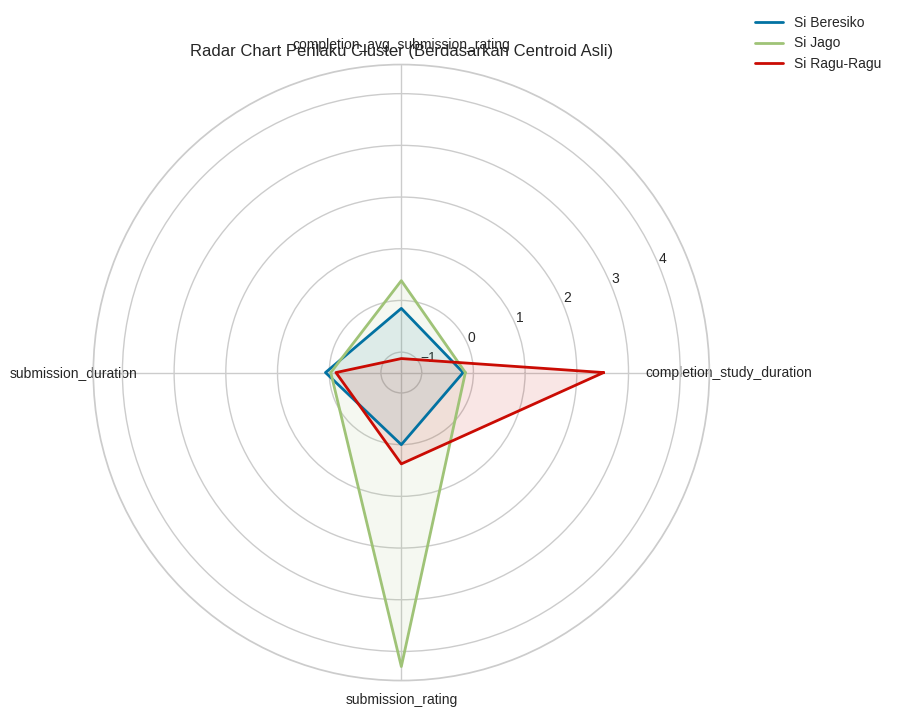

In [ ]:
features = [
    "completion_study_duration",
    "completion_avg_submission_rating",
    "submission_duration",
    "submission_rating"
]

df_radar = pd.DataFrame(centroids, columns=X.iloc[:, :-3].columns)

df_radar = df_radar[features].copy()
df_radar["cluster"] = range(len(df_radar))
df_radar["label"] = df_radar["cluster"].map(label_map)

categories = features
N = len(categories)

plt.figure(figsize=(8, 8))

for idx, row in df_radar.iterrows():
    values = row[features].values.flatten().tolist()
    values += values[:1]  # loop close

    angles = [n / float(N) * 2 * pi for n in range(N)]
    angles += angles[:1]

    plt.polar(
        angles, values,
        linewidth=2,
        label=row["label"]
    )
    plt.fill(angles, values, alpha=0.1)

plt.xticks(
    [n / float(N) * 2 * pi for n in range(N)],
    categories
)

plt.title("Radar Chart Perilaku Cluster (Berdasarkan Centroid Asli)")
plt.legend(loc="upper right", bbox_to_anchor=(1.3, 1.1))

plt.show()

In [ ]:
unique_clusters = np.unique(X["label_cluster"])

if hasattr(centroids, 'values'):
    centroids_array = centroids.values
else:
    centroids_array = centroids

centroids_pca = pca.transform(centroids_array)

pca_df = pd.DataFrame({
    'PC1': X_pca[:, 0],
    'PC2': X_pca[:, 1],
    'Cluster': X["label_cluster"].astype(str)
})

explained_var = pca.explained_variance_ratio_
pc1_var = explained_var[0] * 100
pc2_var = explained_var[1] * 100

colors = px.colors.sequential.Viridis
n_clusters = len(unique_clusters)
cluster_colors = [colors[int(i * (len(colors)-1) / max(1, n_clusters-1))] for i in range(n_clusters)]

fig = go.Figure()

for idx, cluster in enumerate(unique_clusters):
    cluster_data = pca_df[pca_df['Cluster'] == str(cluster)]

    if len(cluster_data) > 10:
        try:
            kde = gaussian_kde(cluster_data[['PC1', 'PC2']].T.values)

            x_min, x_max = cluster_data['PC1'].min(), cluster_data['PC1'].max()
            y_min, y_max = cluster_data['PC2'].min(), cluster_data['PC2'].max()

            x_range = x_max - x_min if x_max != x_min else 1
            y_range = y_max - y_min if y_max != y_min else 1
            x_min, x_max = x_min - 0.3*x_range, x_max + 0.3*x_range
            y_min, y_max = y_min - 0.3*y_range, y_max + 0.3*y_range

            xx, yy = np.mgrid[x_min:x_max:100j, y_min:y_max:100j]
            positions = np.vstack([xx.ravel(), yy.ravel()])
            density = kde(positions).reshape(xx.shape)

            fig.add_trace(go.Contour(
                x=xx[:, 0],
                y=yy[0, :],
                z=density,
                colorscale=[
                    [0, 'rgba(255,255,255,0)'],
                    [0.3, f'rgba{tuple(list(px.colors.hex_to_rgb(cluster_colors[idx])) + [0.15])}'],
                    [0.6, f'rgba{tuple(list(px.colors.hex_to_rgb(cluster_colors[idx])) + [0.35])}'],
                    [1, f'rgba{tuple(list(px.colors.hex_to_rgb(cluster_colors[idx])) + [0.55])}']
                ],
                showscale=False,
                contours=dict(
                    coloring='fill',
                    showlines=True,
                    start=density.min(),
                    end=density.max(),
                    size=(density.max() - density.min()) / 8
                ),
                line=dict(width=1.5, color=cluster_colors[idx]),
                name=f'Density Cluster {cluster}',
                showlegend=False,
                hoverinfo='skip',
                opacity=0.8
            ))

        except Exception as e:
            print(f"Warning: Could not compute KDE for cluster {cluster}: {e}")

marker_symbols = ['circle', 'diamond', 'square', 'cross', 'x', 'triangle-up', 'star']

for idx, cluster in enumerate(unique_clusters):
    cluster_data = pca_df[pca_df['Cluster'] == str(cluster)]

    marker_style = marker_symbols[idx % len(marker_symbols)]

    fig.add_trace(go.Scatter(
        x=cluster_data['PC1'],
        y=cluster_data['PC2'],
        mode='markers',
        name=f'Cluster {cluster}',
        marker=dict(
            size=9,
            color=cluster_colors[idx],
            opacity=0.7,
            symbol=marker_style,
            line=dict(width=1, color='white')
        ),
        hovertemplate='<b>Cluster ' + str(cluster) + '</b><br>' +
                      'PC1: %{x:.3f}<br>' +
                      'PC2: %{y:.3f}<br>' +
                      f'Points: {len(cluster_data)}<br>' +
                      '<extra></extra>'
    ))

fig.add_trace(go.Scatter(
    x=centroids_pca[:, 0],
    y=centroids_pca[:, 1],
    mode='markers+text',
    name='Centroids',
    text=[f'C{i}' for i in unique_clusters],
    textposition='top center',
    textfont=dict(
        size=14,
        color='white',
        family='Arial Black'
    ),
    marker=dict(
        size=28,
        color='#E74C3C',
        symbol='x',
        line=dict(width=4, color='black'),
        opacity=1
    ),
    visible=True,
    hovertemplate='<b>Centroid %{text}</b><br>' +
                  'PC1: %{x:.3f}<br>' +
                  'PC2: %{y:.3f}<br>' +
                  '<extra></extra>'
))

centroid_shapes = []
for i, (cx, cy) in enumerate(centroids_pca):
    centroid_shapes.append(dict(
        type="circle",
        xref="x", yref="y",
        x0=cx-0.8, y0=cy-0.8,
        x1=cx+0.8, y1=cy+0.8,
        line=dict(color="rgba(231, 76, 60, 0.3)", width=3),
        fillcolor="rgba(231, 76, 60, 0.1)",
        visible=True
    ))
    centroid_shapes.append(dict(
        type="circle",
        xref="x", yref="y",
        x0=cx-0.4, y0=cy-0.4,
        x1=cx+0.4, y1=cy+0.4,
        line=dict(color="rgba(231, 76, 60, 0.5)", width=2),
        fillcolor="rgba(231, 76, 60, 0.15)",
        visible=True
    ))

fig.update_layout(
    title={
        'text': f'PCA Visualization – Final {len(unique_clusters)} Kelompok (3D Density Contour)<br>' +
                f'<sub>PC1: {pc1_var:.2f}% | PC2: {pc2_var:.2f}% | Total Variance: {pc1_var+pc2_var:.2f}%</sub>',
        'x': 0.5,
        'xanchor': 'center',
        'font': {'size': 24, 'color': '#2C3E50', 'family': 'Arial Black'}
    },
    xaxis=dict(
        title=dict(
            text=f'<b>PC1</b> ({pc1_var:.2f}% variance)',
            font=dict(size=15, color='#34495E', family='Arial')
        ),
        gridcolor='rgba(189, 195, 199, 0.4)',
        gridwidth=1,
        showgrid=True,
        zeroline=True,
        zerolinewidth=2.5,
        zerolinecolor='rgba(52, 73, 94, 0.3)',
        showline=True,
        linewidth=2,
        linecolor='rgba(52, 73, 94, 0.5)',
        mirror=True
    ),
    yaxis=dict(
        title=dict(
            text=f'<b>PC2</b> ({pc2_var:.2f}% variance)',
            font=dict(size=15, color='#34495E', family='Arial')
        ),
        gridcolor='rgba(189, 195, 199, 0.4)',
        gridwidth=1,
        showgrid=True,
        zeroline=True,
        zerolinewidth=2.5,
        zerolinecolor='rgba(52, 73, 94, 0.3)',
        showline=True,
        linewidth=2,
        linecolor='rgba(52, 73, 94, 0.5)',
        mirror=True
    ),
    plot_bgcolor='rgba(255, 255, 255, 1)',
    paper_bgcolor='rgba(248, 249, 250, 1)',
    hovermode='closest',
    height=900,
    width=1300,
    legend=dict(
        title=dict(
            text='<b>Legend</b>',
            font=dict(size=14, family='Arial Black')
        ),
        orientation="v",
        yanchor="top",
        y=0.98,
        xanchor="right",
        x=0.98,
        bgcolor="rgba(255, 255, 255, 0.97)",
        bordercolor="rgba(52, 73, 94, 0.5)",
        borderwidth=2.5,
        font=dict(size=12, family='Arial'),
        itemsizing='constant',
        tracegroupgap=5
    ),
    font=dict(family="Arial, sans-serif"),
    margin=dict(l=80, r=80, t=120, b=80),
    shapes=centroid_shapes,
    updatemenus=[
        dict(
            type="buttons",
            direction="left",
            buttons=[
                dict(
                    args=[
                        {"visible": [True] * (len(fig.data) - 1) + [True]},  # Show centroids
                        {"shapes": centroid_shapes}
                    ],
                    label="Show Centroids",
                    method="update"
                ),
                dict(
                    args=[
                        {"visible": [True] * (len(fig.data) - 1) + [False]},  # Hide centroids
                        {"shapes": []}
                    ],
                    label="Hide Centroids",
                    method="update"
                )
            ],
            pad={"r": 10, "t": 10},
            showactive=True,
            x=0.02,
            xanchor="left",
            y=1.12,
            yanchor="top",
            bgcolor="rgba(255, 255, 255, 0.9)",
            bordercolor="rgba(52, 73, 94, 0.5)",
            borderwidth=2,
            font=dict(size=12, family='Arial')
        )
    ]
)

fig.add_annotation(
    text=f"Total Data Points: {len(X_pca)} | Clusters: {len(unique_clusters)} | Using label_cluster column",
    xref="paper", yref="paper",
    x=0.5, y=-0.08,
    showarrow=False,
    font=dict(size=11, color='rgba(52, 73, 94, 0.6)', family='Arial'),
    xanchor='center'
)

fig.show()

/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but PCA was fitted with feature names



In [ ]:
# joblib.dump(encoder, "encoder.pkl")
joblib.dump(encoder_label, "encoder_label.pkl")
joblib.dump(scaler, "scaler.pkl")

['scaler.pkl']

In [ ]:
X

,tracking_status,tracking_first_opened_at,tracking_completed_at,completion_created_at,completion_enrolling_times,completion_study_duration,completion_avg_submission_rating,submission_status,submission_created_at,submission_duration,submission_ended_review_at,submission_rating,label,label_cluster,label_cluster_encoding
0,1,-1.788280,0.411015,0.311379,-0.558108,-0.390032,0.973470,1.0,0.443253,-0.267624,0.511230,4.0,1,Si Jago,1
1,1,-1.788280,-2.348728,0.314923,0.946753,-0.364434,-1.906280,-1.0,0.446573,-0.267624,0.514300,0.0,0,Si Beresiko,0
3,1,0.563962,0.428489,0.354961,-0.558108,-0.381499,-0.108126,-1.0,0.478115,0.520625,0.543482,0.0,0,Si Beresiko,0
4,1,0.567185,0.432295,0.361274,0.946753,-0.253511,-1.460121,1.0,0.483588,-0.261940,0.548558,3.0,1,Si Jago,1
5,1,0.554827,0.417704,0.343057,-0.558108,-0.372967,-1.460121,-2.0,0.469057,-0.199410,-1.857450,0.0,0,Si Beresiko,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
318004,1,0.560198,0.424045,0.330322,0.946753,-0.411363,1.243870,1.0,0.477311,-0.222148,0.542737,4.0,1,Si Jago,1
318005,1,0.554460,0.418170,0.342528,-0.558108,-0.138321,-1.906280,-1.0,0.467621,0.823798,0.533778,0.0,0,Si Beresiko,0
318007,0,0.571123,-2.348728,0.362579,0.946753,-0.116990,-0.648924,-1.0,0.482588,-0.254740,0.547622,0.0,0,Si Beresiko,0
318008,1,-1.788280,0.438646,0.333898,0.946753,-0.432695,-0.108126,-1.0,0.461774,-0.244886,0.528360,0.0,0,Si Beresiko,0


In [ ]:
non_scaled_cols = ["submission_rating", "tracking_status", "submission_status"]

X_features = X.iloc[:, :-3]

X_scaled_features = X_features.drop(columns=non_scaled_cols)
X_not_scaled_features = X_features[non_scaled_cols]

X_labels = X.iloc[:, -3:]

X_scaled_inverse = pd.DataFrame(
    scaler.inverse_transform(X_scaled_features),
    columns=X_scaled_features.columns,
    index=X.index
)

X_inverse = pd.concat([
    X_scaled_inverse,
    X_not_scaled_features,
    X_labels
], axis=1)


In [ ]:
X_inverse.shape

(201770, 15)

In [ ]:
N = 3

samples_per_cluster = {}

for c in sorted(X_inverse["label_cluster"].unique()):
    cluster_df = X_inverse[X_inverse["label_cluster"] == c]
    samples_per_cluster[c] = cluster_df.sample(n=min(N, len(cluster_df)), random_state=42)


In [ ]:
for c, df_sample in samples_per_cluster.items():
    print("\n====================================================")
    print(f"   CLUSTER {c} ({df_sample['label'].iloc[0]}) — {len(df_sample)} Contoh Data")
    print("====================================================\n")

    display(df_sample)


   CLUSTER Si Beresiko (0) — 3 Contoh Data



,tracking_first_opened_at,tracking_completed_at,completion_created_at,completion_enrolling_times,completion_study_duration,completion_avg_submission_rating,submission_created_at,submission_duration,submission_ended_review_at,submission_rating,tracking_status,submission_status,label,label_cluster,label_cluster_encoding
71064,1.667188e+09,1.667189e+09,1.671515e+09,1.0,50.0,3.0,1.670081e+09,300.0,-9.223372e+09,0.0,1,-2.0,0,Si Beresiko,0
106659,1.654169e+09,1.654172e+09,1.654184e+09,1.0,2.0,5.0,1.747392e+09,120.0,1.747392e+09,0.0,1,-1.0,0,Si Beresiko,0
291051,1.713654e+09,1.749507e+09,1.714723e+09,1.0,464.0,5.0,1.714396e+09,1440.0,1.714396e+09,0.0,1,-1.0,0,Si Beresiko,0



   CLUSTER Si Jago (1) — 3 Contoh Data



,tracking_first_opened_at,tracking_completed_at,completion_created_at,completion_enrolling_times,completion_study_duration,completion_avg_submission_rating,submission_created_at,submission_duration,submission_ended_review_at,submission_rating,tracking_status,submission_status,label,label_cluster,label_cluster_encoding
227131,1.712691e+09,1.712691e+09,1.736943e+09,1.0,351.0,5.00,1.736932e+09,600.0,1.736943e+09,5.0,1,1.0,1,Si Jago,1
73994,-9.223372e+09,-9.223372e+09,1.605788e+09,1.0,46.0,4.33,1.602536e+09,0.0,1.602604e+09,5.0,0,1.0,1,Si Jago,1
64358,1.685974e+09,1.736349e+09,1.687448e+09,1.0,19.0,5.00,1.687440e+09,120.0,1.687448e+09,5.0,1,1.0,1,Si Jago,1



   CLUSTER Si Ragu-Ragu (2) — 3 Contoh Data



,tracking_first_opened_at,tracking_completed_at,completion_created_at,completion_enrolling_times,completion_study_duration,completion_avg_submission_rating,submission_created_at,submission_duration,submission_ended_review_at,submission_rating,tracking_status,submission_status,label,label_cluster,label_cluster_encoding
150994,1.632384e+09,1.675875e+09,1.672741e+09,1.0,469.0,3.33,1.668008e+09,150.0,1.668011e+09,0.0,1,-1.0,2,Si Ragu-Ragu,2
305050,1.693219e+09,1.693467e+09,1.693467e+09,1.0,703.0,3.00,1.634880e+09,60.0,1.634952e+09,0.0,1,-1.0,2,Si Ragu-Ragu,2
219365,1.643833e+09,1.643833e+09,1.644452e+09,1.0,822.0,4.50,1.644344e+09,1380.0,1.644371e+09,0.0,1,-1.0,2,Si Ragu-Ragu,2


In [ ]:
X["label"].unique(), X["label_cluster"].unique(), X["label_cluster_encoding"].unique()

(array([1, 0, 2], dtype=int32),
 array(['Si Jago', 'Si Beresiko', 'Si Ragu-Ragu'], dtype=object),
 array([1, 0, 2]))

In [ ]:
X_inverse.head()

,tracking_first_opened_at,tracking_completed_at,completion_created_at,completion_enrolling_times,completion_study_duration,completion_avg_submission_rating,submission_created_at,submission_duration,submission_ended_review_at,submission_rating,tracking_status,submission_status,label,label_cluster,label_cluster_encoding
0,-9.223372e+09,1.640855e+09,1.565183e+09,1.0,46.0,4.80,1.562637e+09,0.0,1.562689e+09,4.0,1,1.0,1,Si Jago,1
1,-9.223372e+09,-9.223372e+09,1.577082e+09,2.0,52.0,2.67,1.576626e+09,0.0,1.576667e+09,0.0,1,-1.0,0,Si Beresiko,0
3,1.709646e+09,1.709646e+09,1.711472e+09,1.0,48.0,4.00,1.709544e+09,2080.0,1.709548e+09,0.0,1,-1.0,0,Si Beresiko,0
4,1.724629e+09,1.724629e+09,1.732664e+09,2.0,78.0,3.00,1.732610e+09,15.0,1.732664e+09,3.0,1,1.0,1,Si Jago,1
5,1.667189e+09,1.667189e+09,1.671515e+09,1.0,50.0,3.00,1.671376e+09,180.0,-9.223372e+09,0.0,1,-2.0,0,Si Beresiko,0


In [ ]:
# Menyimpan data hasil clustering
X.to_csv("learnalytica_label.csv", index=False)

# EDA

In [ ]:
df_big = pd.read_csv("learnalytica_label.csv")

In [ ]:
# =======================================
# EDA CELL 1 — Shape & Sample
# =======================================

print("=== SHAPE DATASET ===")
print(df_big.shape)

print("\n=== 5 DATA TERATAS ===")
display(df_big.head())


=== SHAPE DATASET ===
(201770, 15)

=== 5 DATA TERATAS ===


,tracking_status,tracking_first_opened_at,tracking_completed_at,completion_created_at,completion_enrolling_times,completion_study_duration,completion_avg_submission_rating,submission_status,submission_created_at,submission_duration,submission_ended_review_at,submission_rating,label,label_cluster,label_cluster_encoding
0,1,-1.788280,0.411015,0.311379,-0.558108,-0.390032,0.973470,1.0,0.443253,-0.267624,0.511230,4.0,1,Si Jago,1
1,1,-1.788280,-2.348728,0.314923,0.946753,-0.364434,-1.906280,-1.0,0.446573,-0.267624,0.514300,0.0,0,Si Beresiko,0
2,1,0.563962,0.428489,0.354961,-0.558108,-0.381499,-0.108126,-1.0,0.478115,0.520625,0.543482,0.0,0,Si Beresiko,0
3,1,0.567185,0.432295,0.361274,0.946753,-0.253511,-1.460121,1.0,0.483588,-0.261940,0.548558,3.0,1,Si Jago,1
4,1,0.554827,0.417704,0.343057,-0.558108,-0.372967,-1.460121,-2.0,0.469057,-0.199410,-1.857450,0.0,0,Si Beresiko,0


In [ ]:
# =======================================
# EDA CELL 2 — Info Kolom
# =======================================

print("=== INFO KOLOM ===")
df_big.info()


=== INFO KOLOM ===
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 201770 entries, 0 to 201769
Data columns (total 15 columns):
 #   Column                            Non-Null Count   Dtype  
---  ------                            --------------   -----  
 0   tracking_status                   201770 non-null  int64  
 1   tracking_first_opened_at          201770 non-null  float64
 2   tracking_completed_at             201770 non-null  float64
 3   completion_created_at             201770 non-null  float64
 4   completion_enrolling_times        201770 non-null  float64
 5   completion_study_duration         201770 non-null  float64
 6   completion_avg_submission_rating  201770 non-null  float64
 7   submission_status                 201770 non-null  float64
 8   submission_created_at             201770 non-null  float64
 9   submission_duration               201770 non-null  float64
 10  submission_ended_review_at        201770 non-null  float64
 11  submission_rating                

In [ ]:
# =======================================
# EDA CELL 3 — Missing Values
# =======================================

print("=== MISSING VALUES PER KOLOM ===")
missing = df_big.isna().sum().sort_values(ascending=False)
display(missing)


=== MISSING VALUES PER KOLOM ===


,0
tracking_status,0
tracking_first_opened_at,0
tracking_completed_at,0
completion_created_at,0
completion_enrolling_times,0
completion_study_duration,0
completion_avg_submission_rating,0
submission_status,0
submission_created_at,0
submission_duration,0


In [ ]:
# =======================================
# EDA CELL 4 — Statistik Numerik
# =======================================

num_cols = df_big.select_dtypes(include=['int64','float64']).columns
print("=== STATISTIK NUMERIK ===")
display(df_big[num_cols].describe())


=== STATISTIK NUMERIK ===


,tracking_status,tracking_first_opened_at,tracking_completed_at,completion_created_at,completion_enrolling_times,completion_study_duration,completion_avg_submission_rating,submission_status,submission_created_at,submission_duration,submission_ended_review_at,submission_rating,label,label_cluster_encoding
count,201770.000000,201770.000000,201770.000000,201770.000000,201770.000000,201770.000000,201770.000000,201770.000000,201770.000000,201770.000000,201770.000000,201770.000000,201770.000000,201770.000000
mean,0.986861,0.298518,0.335778,0.347060,-0.004344,0.091281,-0.034234,-0.222550,0.473755,0.010592,0.409046,1.769416,0.604059,0.604059
std,0.113869,0.737085,0.489576,0.015136,0.965505,1.041576,0.979402,1.055377,0.011775,0.966277,0.543988,2.156707,0.663151,0.663151
min,0.000000,-1.788280,-2.348728,0.283489,-0.558108,-0.586281,-5.516107,-2.000000,0.421285,-0.267624,-1.857450,0.000000,0.000000,0.000000
25%,1.000000,0.547876,0.415435,0.339764,-0.558108,-0.428429,-0.648924,-1.000000,0.467575,-0.256255,0.531565,0.000000,0.000000,0.000000
50%,1.000000,0.557143,0.424650,0.348571,-0.558108,-0.257777,-0.108126,-1.000000,0.474648,-0.199410,0.540120,0.000000,1.000000,1.000000
75%,1.000000,0.567228,0.434696,0.359457,0.946753,-0.082859,0.973470,1.000000,0.483515,-0.085721,0.548329,4.000000,1.000000,1.000000
max,1.000000,0.575280,0.441852,0.370007,8.471056,7.818303,1.243870,1.000000,0.490557,16.104471,0.554995,5.000000,2.000000,2.000000


In [ ]:
# =======================================
# EDA CELL 5 — Unique Values Per Kolom
# =======================================

print("=== UNIQUE VALUES (user/journey/tutorial/score) ===")
important_cols = ["user_id", "journey_id", "tutorial_id", "score", "is_passed"]

for col in important_cols:
    if col in df_big.columns:
        print(f"{col}: {df_big[col].nunique()} unique")


=== UNIQUE VALUES (user/journey/tutorial/score) ===


In [ ]:
# =======================================
# EDA CELL 6 — Tipe Data Summary
# =======================================

print("=== TIPE DATA (COUNTER) ===")
dtype_counts = df_big.dtypes.value_counts()
display(dtype_counts)


=== TIPE DATA (COUNTER) ===


,count
float64,11
int64,3
object,1


In [ ]:
# =======================================
# EDA CELL 7 — Deteksi Timestamp
# =======================================

timestamp_cols = []
for col in df_big.columns:
    if "at" in col.lower() or "date" in col.lower():
        timestamp_cols.append(col)

print("Kolom timestamp terdeteksi:", timestamp_cols)

# Convert to datetime (jaga-jaga)
for col in timestamp_cols:
    df_big[col] = pd.to_datetime(df_big[col], errors='coerce')


Kolom timestamp terdeteksi: ['tracking_status', 'tracking_first_opened_at', 'tracking_completed_at', 'completion_created_at', 'completion_study_duration', 'completion_avg_submission_rating', 'submission_status', 'submission_created_at', 'submission_duration', 'submission_ended_review_at', 'submission_rating']


In [ ]:
# =======================================
# EDA CELL 8 — Rentang Waktu Belajar
# =======================================

print("=== RENTANG WAKTU DATA ===")
for col in timestamp_cols:
    print(f"{col}: min = {df_big[col].min()}, max = {df_big[col].max()}")


=== RENTANG WAKTU DATA ===
first_opened_at: min = 2017-12-25 02:01:00, max = 2025-11-07 08:36:45
completed_at: min = 2019-05-12 13:06:05, max = 2025-11-07 08:36:45
status: min = 1970-01-01 00:00:00, max = 1970-01-01 00:00:00.000000001
developer_journey_status_hash: min = NaT, max = NaT
created_at: min = 2016-08-01 14:15:02, max = 2025-10-24 18:41:06


## Cek Distribusi & Correlation Data

In [ ]:
# =======================================
# DISTRIBUSI CELL 1 — user/journey/tutorial
# =======================================

print("=== DISTRIBUSI USER ===")
print("Jumlah user unik:", df_big["user_id"].nunique())
display(df_big["user_id"].value_counts().head())

print("\n=== DISTRIBUSI JOURNEY (kelas) ===")
print("Jumlah journey unik:", df_big["journey_id"].nunique())
display(df_big["journey_id"].value_counts().head())

print("\n=== DISTRIBUSI TUTORIAL (materi) ===")
print("Jumlah tutorial unik:", df_big["tutorial_id"].nunique())
display(df_big["tutorial_id"].value_counts().head())


=== DISTRIBUSI USER ===
Jumlah user unik: 31


,count
user_id,
531259,8194
32258,6117
1202367,6004
496740,5875
102556,5713



=== DISTRIBUSI JOURNEY (kelas) ===
Jumlah journey unik: 181


,count
journey_id,
123,3992
266,3700
256,3609
219,3077
163,3023



=== DISTRIBUSI TUTORIAL (materi) ===
Jumlah tutorial unik: 9682


,count
tutorial_id,
12992,96
15505,96
14097,81
13062,70
4774,69


In [ ]:
# =======================================
# DISTRIBUSI CELL 2 — score & is_passed
# =======================================

if "score" in df_big.columns:
    print("=== DISTRIBUSI SCORE ===")
    display(df_big["score"].describe())
    print("\nTop 10 skor tertinggi:")
    display(df_big["score"].sort_values(ascending=False).head())

if "is_passed" in df_big.columns:
    print("\n=== DISTRIBUSI STATUS LULUS ===")
    display(df_big["is_passed"].value_counts(dropna=False))


=== DISTRIBUSI SCORE ===


,score
count,43467.000000
mean,74.910415
std,27.761996
min,0.000000
25%,50.000000
50%,80.000000
75%,100.000000
max,100.000000



Top 10 skor tertinggi:


,score
317925,100.0
317924,100.0
317886,100.0
257800,100.0
257799,100.0



=== DISTRIBUSI STATUS LULUS ===


,count
is_passed,
NaN,274544
1.0,30038
0.0,13429


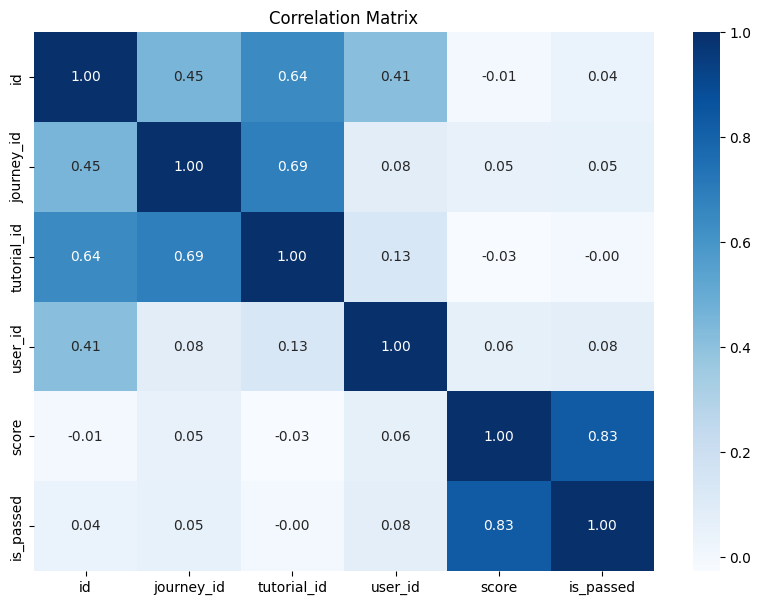

In [ ]:
# =======================================
# KORELASI CELL 1 — Heatmap Numeric
# =======================================

import seaborn as sns
import matplotlib.pyplot as plt

num_df = df_big.select_dtypes(include=['int64', 'float64'])

plt.figure(figsize=(10,7))
sns.heatmap(num_df.corr(), annot=True, cmap="Blues", fmt=".2f")
plt.title("Correlation Matrix")
plt.show()


In [ ]:
# =======================================
# KORELASI CELL 2 — Score vs Other Features
# =======================================

if "score" in df_big.columns:
    corr_with_score = num_df.corr()["score"].sort_values(ascending=False)
    print("=== KORELASI SCORE DENGAN FITUR LAIN ===")
    display(corr_with_score)
else:
    print("Score tidak ada di dataset.")


=== KORELASI SCORE DENGAN FITUR LAIN ===


,score
score,1.000000
is_passed,0.830850
user_id,0.061340
journey_id,0.050938
id,-0.006487
tutorial_id,-0.027232


In [ ]:
# =======================================
# KORELASI CELL 3 — is_passed vs numeric
# =======================================

if "is_passed" in num_df.columns:
    corr_with_pass = num_df.corr()["is_passed"].sort_values(ascending=False)
    print("=== KORELASI is_passed DENGAN FITUR LAIN ===")
    display(corr_with_pass)
else:
    print("is_passed tidak ditemukan.")


=== KORELASI is_passed DENGAN FITUR LAIN ===


,is_passed
is_passed,1.000000
score,0.830850
user_id,0.075735
journey_id,0.053110
id,0.043483
tutorial_id,-0.000351


## Cek Nan & Duplicate Data

In [ ]:
# =======================================
# NAN CELL 1 — Missing Values Summary
# =======================================

print("=== TOTAL MISSING VALUES PER KOLOM ===")
missing = df_big.isna().sum().sort_values(ascending=False)
display(missing)

print("\nKolom dengan missing > 0:")
display(missing[missing > 0])


=== TOTAL MISSING VALUES PER KOLOM ===


,0
developer_journey_status_hash,106180
score,93957
is_passed,93957
created_at,54690
first_opened_at,29656
completed_at,22002
last_viewed,35
journey_id,0
tutorial_id,0
user_id,0



Kolom dengan missing > 0:


,0
developer_journey_status_hash,106180
score,93957
is_passed,93957
created_at,54690
first_opened_at,29656
completed_at,22002
last_viewed,35


In [ ]:
# =======================================
# NAN CELL 2 — Persentase Missing
# =======================================

missing_pct = (df_big.isna().sum() / len(df_big)) * 100
missing_pct = missing_pct.sort_values(ascending=False)

print("=== PERSENTASE MISSING VALUES (%) ===")
display(missing_pct)


=== PERSENTASE MISSING VALUES (%) ===


,0
developer_journey_status_hash,100.000000
score,88.488416
is_passed,88.488416
created_at,51.506875
first_opened_at,27.929930
completed_at,20.721416
last_viewed,0.032963
journey_id,0.000000
tutorial_id,0.000000
user_id,0.000000


In [ ]:
# =======================================
# DUPLICATE CELL 1 — Hitung Duplicate
# =======================================

duplicate_count = df_big.duplicated().sum()
print("=== JUMLAH DUPLICATE ROWS:", duplicate_count)


=== JUMLAH DUPLICATE ROWS: 0


In [ ]:
# =======================================
# DUPLICATE CELL 2 — Tampilkan Duplicate
# =======================================

if duplicate_count > 0:
    print("=== 5 DUPLICATE ROWS ===")
    display(df_big[df_big.duplicated()].head())
else:
    print("Tidak ada duplicate row.")


Tidak ada duplicate row.


## Cek Distribusi Class Target

In [ ]:
# =======================================
# STEP 1 — Persiapan dan parsing datetime
# =======================================

df_temp = df_big.copy()

# convert datetime jika belum
for col in ["first_opened_at", "last_viewed", "created_at"]:
    if col in df_temp.columns:
        df_temp[col] = pd.to_datetime(df_temp[col], errors="coerce")

# buat kolom hari aktif
if "first_opened_at" in df_temp.columns:
    df_temp["day"] = df_temp["first_opened_at"].dt.date

In [ ]:
# =======================================
# STEP 2 — Agregasi df_user
# =======================================

df_user = df_temp.groupby("user_id").agg({
    "tutorial_id": "nunique",
    "day": "nunique",
    "score": "mean",
    "is_passed": "mean"
}).reset_index()

df_user = df_user.rename(columns={
    "tutorial_id": "total_materials",
    "day": "active_days",
    "score": "mean_score",
    "is_passed": "pass_rate"
})

# materials per day
df_user["materials_per_day"] = df_user["total_materials"] / df_user["active_days"]

# handle missing
df_user["materials_per_day"] = df_user["materials_per_day"].fillna(0)
df_user["mean_score"] = df_user["mean_score"].fillna(0)
df_user["pass_rate"] = df_user["pass_rate"].fillna(0)

display(df_user.head())


,user_id,total_materials,active_days,mean_score,pass_rate,materials_per_day
0,3390,5526,230,80.095602,0.741874,24.026087
1,5774,2628,94,71.706199,0.646900,27.957447
2,11836,3271,107,82.034483,0.827586,30.570093
3,17833,3809,197,86.534884,0.863787,19.335025
4,32258,5942,240,84.760204,0.823129,24.758333


In [ ]:
# =======================================
# STEP 3 — Labelling class target
# =======================================

# ambil kuartil 75 persen untuk menentukan user cepat
q75 = df_user["materials_per_day"].quantile(0.75)

def assign_label(row):
    if row["materials_per_day"] >= q75:
        return "Fast"
    if row["mean_score"] < 50 or row["pass_rate"] < 0.4:
        return "At Risk"
    return "Consistent"

df_user["class_target"] = df_user.apply(assign_label, axis=1)

display(df_user.head())
df_user["class_target"].value_counts()


,user_id,total_materials,active_days,mean_score,pass_rate,materials_per_day,class_target
0,3390,5526,230,80.095602,0.741874,24.026087,Consistent
1,5774,2628,94,71.706199,0.646900,27.957447,Consistent
2,11836,3271,107,82.034483,0.827586,30.570093,Consistent
3,17833,3809,197,86.534884,0.863787,19.335025,Consistent
4,32258,5942,240,84.760204,0.823129,24.758333,Consistent


,count
class_target,
Consistent,21
Fast,8
At Risk,2


In [ ]:
# =======================================
# STEP 4 — Distribusi class target
# =======================================

print("=== Distribusi jumlah per class ===")
display(df_big["label_cluster"].value_counts())

print("\n=== Distribusi persen per class ===")
display((df_big["label_cluster"].value_counts(normalize=True) * 100).round(2))


=== Distribusi jumlah per class ===


,count
label_cluster,
Si Beresiko,100126
Si Jago,81407
Si Ragu-Ragu,20237



=== Distribusi persen per class ===


,proportion
label_cluster,
Si Beresiko,49.62
Si Jago,40.35
Si Ragu-Ragu,10.03


/tmp/ipython-input-3690514456.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df_big, x="label_cluster", palette="Blues")


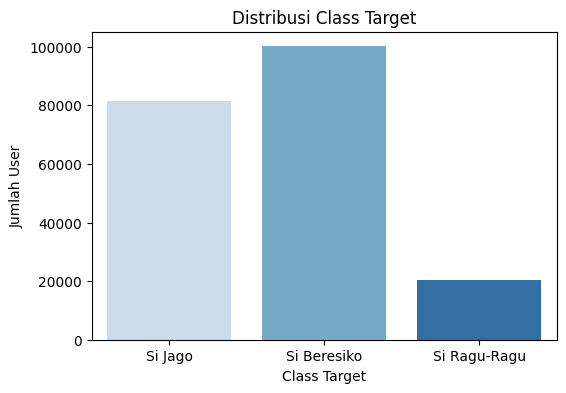

In [ ]:
# =======================================
# STEP 5 — Visual plot class target
# =======================================

import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(6,4))
sns.countplot(data=df_big, x="label_cluster", palette="Blues")
plt.title("Distribusi Class Target")
plt.xlabel("Class Target")
plt.ylabel("Jumlah User")
plt.show()


In [ ]:
# =======================================
# STEP 6 — Statistik per class target
# =======================================

df_summary = df_user.groupby("class_target")[[
    "total_materials",
    "active_days",
    "materials_per_day",
    "mean_score",
    "pass_rate"
]].mean()

print("=== Profil rata rata per class ===")
display(df_summary)


# Preprocessing (Setelah jalanin read_csv langsung kesini)


In [ ]:
"""
=== INFO KOLOM ===
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 201770 entries, 0 to 201769
Data columns (total 15 columns):
 #   Column                            Non-Null Count   Dtype
---  ------                            --------------   -----
 0   tracking_status                   201770 non-null  int64
 1   tracking_first_opened_at          201770 non-null  float64
 2   tracking_completed_at             201770 non-null  float64
 3   completion_created_at             201770 non-null  float64
 4   completion_enrolling_times        201770 non-null  float64
 5   completion_study_duration         201770 non-null  float64
 6   completion_avg_submission_rating  201770 non-null  float64
 7   submission_status                 201770 non-null  float64
 8   submission_created_at             201770 non-null  float64
 9   submission_duration               201770 non-null  float64
 10  submission_ended_review_at        201770 non-null  float64
 11  submission_rating                 201770 non-null  float64
 12  label                             201770 non-null  int64
 13  label_cluster                     201770 non-null  object
 14  label_cluster_encoding            201770 non-null  int64
dtypes: float64(11), int64(3), object(1)
memory usage: 23.1+ MB
"""

In [ ]:
data = (
    df_big.groupby("label_cluster", group_keys=False)
      .apply(lambda x: x.sample(n=min(25000, len(x)), random_state=42))
      .reset_index(drop=True)
)

print(data["label_cluster"].value_counts())

label_cluster
Si Beresiko     25000
Si Jago         25000
Si Ragu-Ragu    20237
Name: count, dtype: int64


/tmp/ipython-input-2680728362.py:3: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(lambda x: x.sample(n=min(25000, len(x)), random_state=42))


In [ ]:
data.head()

,tracking_status,tracking_first_opened_at,tracking_completed_at,completion_created_at,completion_enrolling_times,completion_study_duration,completion_avg_submission_rating,submission_status,submission_created_at,submission_duration,submission_ended_review_at,submission_rating,label,label_cluster,label_cluster_encoding
0,1,0.554827,0.417704,0.343057,-0.558108,-0.372967,-1.460121,-2.0,0.468750,-0.153935,-1.857450,0.0,0,Si Beresiko,0
1,1,0.552026,0.414398,0.337893,-0.558108,-0.577749,1.243870,-1.0,0.487096,-0.222148,0.551792,0.0,0,Si Beresiko,0
2,1,0.564824,0.438615,0.355929,-0.558108,1.393276,1.243870,-1.0,0.479266,0.278087,0.544546,0.0,0,Si Beresiko,0
3,1,0.570856,0.436629,0.364142,-0.558108,-0.436961,-0.784124,-1.0,0.485743,-0.244886,0.550547,0.0,0,Si Beresiko,0
4,1,0.546639,0.413548,0.330808,-0.558108,-0.475358,0.432672,-2.0,0.459318,-0.267624,-1.857450,0.0,0,Si Beresiko,0


## Delete Outlier and Duplicate Data

- Perhatikan dan Pahamin data apakah perlu di hapus atau tidak

In [ ]:
data = data.dropna()

In [ ]:
data.duplicated().sum()

np.int64(0)

## Split Dataset

In [ ]:
X = data.drop(columns=["label", "label_cluster", "label_cluster_encoding"])
y = data["label_cluster_encoding"]

In [ ]:
# numpy.ndarray

X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.15, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_train_val, y_train_val, test_size=0.176, random_state=42)

In [ ]:
print(f"Number of training samples (X_train) : {len(X_train)}")
print(f"Number of validation samples (X_val): {len(X_val)}")
print(f"Number of test samples (X_test): {len(X_test)}")

print(f"Number of training label samples (y_train) : {len(y_train)}")
print(f"Number of validation label samples (y_val): {len(y_val)}")
print(f"Number of test samples label (y_test): {len(y_test)}")

Number of training samples (X_train) : 49193
Number of validation samples (X_val): 10508
Number of test samples (X_test): 10536
Number of training label samples (y_train) : 49193
Number of validation label samples (y_val): 10508
Number of test samples label (y_test): 10536


In [ ]:
X_train.shape, y_train.shape, X_train.columns

((49193, 12),
 (49193,),
 Index(['tracking_status', 'tracking_first_opened_at', 'tracking_completed_at',
        'completion_created_at', 'completion_enrolling_times',
        'completion_study_duration', 'completion_avg_submission_rating',
        'submission_status', 'submission_created_at', 'submission_duration',
        'submission_ended_review_at', 'submission_rating'],
       dtype='object'))

In [ ]:
X_train

,tracking_status,tracking_first_opened_at,tracking_completed_at,completion_created_at,completion_enrolling_times,completion_study_duration,completion_avg_submission_rating,submission_status,submission_created_at,submission_duration,submission_ended_review_at,submission_rating
5971,1,-1.788280,0.424935,0.328534,0.946753,-0.479624,1.243870,-1.0,0.465475,0.422094,0.531810,0.0
69729,1,0.560784,0.424738,0.363305,-0.558108,1.636454,-1.460121,-1.0,0.485208,-0.142566,0.550045,0.0
18962,1,0.551003,0.413189,0.336757,-0.558108,-0.483890,1.243870,-1.0,0.464052,2.473438,0.530467,0.0
16383,1,0.571806,0.437751,0.365949,-0.558108,-0.415630,1.243870,-1.0,0.487131,0.141659,0.551905,0.0
45519,1,0.563982,0.428513,0.330862,-0.558108,-0.513754,1.243870,1.0,0.459356,-0.267624,0.526140,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...
8997,1,0.565155,0.429898,0.356178,-0.558108,-0.398565,0.567872,-1.0,0.479468,-0.153935,0.544738,0.0
29607,1,0.547643,0.409223,0.349322,2.451613,-0.385766,0.338033,1.0,0.473709,0.073445,0.539404,5.0
69372,1,0.547401,0.424193,0.349597,-0.558108,2.412918,-1.460121,-1.0,0.460277,-0.244886,0.526980,0.0
27040,1,0.555055,0.417974,0.343422,-0.558108,1.414607,-1.013963,1.0,0.468300,-0.216464,0.534409,4.0


## Feature Selection

In [ ]:
mi_scores = mutual_info_classif(X, y, random_state=42)
mi_scores = pd.Series(mi_scores, index=X.columns).sort_values(ascending=False)

def categorize_feature(score):
    if score >= 0.1:
        return 'Sangat Penting'
    elif score >= 0.05:
        return 'Penting'
    elif score >= 0.01:
        return 'Cukup Penting'
    else:
        return 'Kurang Penting'

mi_df = pd.DataFrame({
    'Feature': mi_scores.index,
    'MI_Score': mi_scores.values,
    'Kategori': [categorize_feature(score) for score in mi_scores.values],
    'Rank': range(1, len(mi_scores) + 1)
})

color_map = {
    'Sangat Penting': '#00CC96',
    'Penting': '#636EFA',
    'Cukup Penting': '#FFA15A',
    'Kurang Penting': '#EF553B'
}

In [ ]:
fig = go.Figure()

for kategori in ['Sangat Penting', 'Penting', 'Cukup Penting', 'Kurang Penting']:
    data_kategori = mi_df[mi_df['Kategori'] == kategori]
    fig.add_trace(go.Bar(
        x=data_kategori['Feature'],
        y=data_kategori['MI_Score'],
        name=kategori,
        marker_color=color_map[kategori],
        hovertemplate='<b>%{x}</b><br>' +
                      'MI Score: %{y:.4f}<br>' +
                      'Rank: #' + data_kategori['Rank'].astype(str) + '<br>' +
                      'Kategori: ' + kategori + '<br>' +
                      '<extra></extra>'
    ))

fig.update_layout(
    title={
        'text': 'Skor Mutual Information<br><sub>Fitur dikelompokkan berdasarkan tingkat kepentingan</sub>',
        'x': 0.5,
        'xanchor': 'center',
        'font': {'size': 22, 'color': '#2C3E50'}
    },
    xaxis_title='Fitur',
    yaxis_title='MI Score',
    hovermode='closest',
    height=700,
    width=1800,
    showlegend=True,
    legend=dict(
        title="Kategori Fitur",
        orientation="v",
        yanchor="top",
        y=1,
        xanchor="right",
        x=1.12,
        bgcolor="rgba(255,255,255,0.9)",
        bordercolor="#CCCCCC",
        borderwidth=1
    ),
    plot_bgcolor='rgba(248,249,250,1)',
    xaxis={
        'tickangle': -45,
        'gridcolor': 'rgba(200,200,200,0.3)'
    },
    yaxis={
        'gridcolor': 'rgba(200,200,200,0.3)'
    },
    font=dict(size=11)
)

fig.add_hline(y=0.1, line_dash="dash", line_color="green",
              annotation_text="Threshold: Sangat Penting (0.1)",
              annotation_position="right")
fig.add_hline(y=0.05, line_dash="dash", line_color="blue",
              annotation_text="Threshold: Penting (0.05)",
              annotation_position="right")
fig.add_hline(y=0.01, line_dash="dash", line_color="orange",
              annotation_text="Threshold: Cukup Penting (0.01)",
              annotation_position="right")

fig.show()

In [ ]:
mi_scores_global = mi_scores
mi_df_global = mi_df

In [ ]:
mi_df_sorted = mi_df.sort_values('MI_Score', ascending=False).reset_index(drop=True)
mi_df_sorted['Cumulative_MI'] = mi_df_sorted['MI_Score'].cumsum()
mi_df_sorted['Cumulative_Pct'] = (mi_df_sorted['Cumulative_MI'] / mi_df_sorted['MI_Score'].sum()) * 100

fig = make_subplots(
    rows=2, cols=1,
    subplot_titles=(
        'Distribusi MI Score (Histogram)',
        'Analisis Pareto - Kurva Kumulatif'
    ),
    vertical_spacing=0.12,
    row_heights=[0.35, 0.65]
)

fig.add_trace(
    go.Histogram(
        x=mi_df['MI_Score'],
        nbinsx=40,
        name='Distribusi MI',
        marker=dict(
            color='#636EFA',
            line=dict(color='white', width=1)
        ),
        hovertemplate='MI Score Range: %{x:.4f}<br>Frekuensi: %{y}<extra></extra>',
        showlegend=False
    ),
    row=1, col=1
)

mean_mi = mi_df['MI_Score'].mean()
median_mi = mi_df['MI_Score'].median()

fig.add_vline(x=mean_mi, line_dash="dash", line_color="red",
              annotation_text=f"Mean: {mean_mi:.4f}",
              annotation_position="top right", row=1, col=1)
fig.add_vline(x=median_mi, line_dash="dash", line_color="green",
              annotation_text=f"Median: {median_mi:.4f}",
              annotation_position="top left", row=1, col=1)

fig.add_trace(
    go.Scatter(
        x=list(range(1, len(mi_df_sorted) + 1)),
        y=mi_df_sorted['Cumulative_Pct'],
        mode='lines',
        name='Kumulatif %',
        line=dict(color='#00CC96', width=4),
        fill='tozeroy',
        fillcolor='rgba(0,204,150,0.2)',
        hovertemplate='Fitur ke-%{x}<br>Kumulatif: %{y:.2f}%<extra></extra>'
    ),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(
        x=list(range(1, len(mi_df_sorted) + 1))[::max(1, len(mi_df_sorted)//20)],
        y=mi_df_sorted['Cumulative_Pct'].iloc[::max(1, len(mi_df_sorted)//20)],
        mode='markers',
        name='Data Points',
        marker=dict(size=8, color='#636EFA', symbol='diamond'),
        showlegend=False,
        hovertemplate='Fitur ke-%{x}<br>Kumulatif: %{y:.2f}%<extra></extra>'
    ),
    row=2, col=1
)

fig.add_hline(y=80, line_dash="dash", line_color="red", line_width=2,
              annotation_text="80% Threshold (Pareto Principle)",
              annotation_position="right", row=2, col=1)
fig.add_hline(y=90, line_dash="dash", line_color="orange", line_width=2,
              annotation_text="90% Threshold",
              annotation_position="right", row=2, col=1)
fig.add_hline(y=95, line_dash="dot", line_color="blue", line_width=1,
              annotation_text="95%",
              annotation_position="right", row=2, col=1)

fig.update_xaxes(title_text="MI Score", row=1, col=1, gridcolor='rgba(200,200,200,0.3)')
fig.update_yaxes(title_text="Frekuensi", row=1, col=1, gridcolor='rgba(200,200,200,0.3)')
fig.update_xaxes(title_text="Jumlah Fitur (Ranked)", row=2, col=1, gridcolor='rgba(200,200,200,0.3)')
fig.update_yaxes(title_text="Persentase Kumulatif (%)", row=2, col=1, gridcolor='rgba(200,200,200,0.3)')

fig.update_layout(
    height=1000,
    showlegend=True,
    title={
        'text': 'Analisis Distribusi & Pareto - Mutual Information<br><sub>Prinsip 80/20: Berapa fitur yang berkontribusi paling besar?</sub>',
        'x': 0.5,
        'xanchor': 'center',
        'font': {'size': 22, 'color': '#2C3E50'}
    },
    plot_bgcolor='rgba(248,249,250,1)',
    font=dict(size=11)
)

fig.show()

# Modelling

In [ ]:
k_values = range(1, 21)
metrics_result = {'k': [], 'accuracy': [], 'precision': [], 'recall': [], 'f1': []}

In [ ]:
for k in k_values:
    dt = KNeighborsClassifier(
        n_neighbors=k,
        metric='euclidean'
    )
    dt.fit(X_train, y_train)
    y_pred = dt.predict(X_val)

    metrics_result['k'].append(k)
    metrics_result['accuracy'].append(accuracy_score(y_val, y_pred))
    metrics_result['precision'].append(precision_score(y_val, y_pred, average='weighted', zero_division=0))
    metrics_result['recall'].append(recall_score(y_val, y_pred, average='weighted', zero_division=0))
    metrics_result['f1'].append(f1_score(y_val, y_pred, average='weighted', zero_division=0))

metrics_df = pd.DataFrame(metrics_result)

## Stacking Classifier

In [ ]:
stack = StackingClassifier(
    estimators=[
        ('xgb', XGBClassifier(eval_metric="logloss", random_state=42)),
        ('lgbm', LGBMClassifier(random_state=42)),
        ('cat', CatBoostClassifier(verbose=0, random_state=42))
    ],
    final_estimator=LogisticRegression(max_iter=2000, solver='lbfgs'),
    passthrough=True
)
stack.fit(X_train, y_train)


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003856 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1682
[LightGBM] [Info] Number of data points in the train set: 49193, number of used features: 12
[LightGBM] [Info] Start training from score -1.032180
[LightGBM] [Info] Start training from score -1.036756
[LightGBM] [Info] Start training from score -1.240750
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spl

StackingClassifier(estimators=[('xgb',
                                XGBClassifier(base_score=None, booster=None,
                                              callbacks=None,
                                              colsample_bylevel=None,
                                              colsample_bynode=None,
                                              colsample_bytree=None,
                                              device=None,
                                              early_stopping_rounds=None,
                                              enable_categorical=False,
                                              eval_metric='logloss',
                                              feature_types=None,
                                              feature_weights=None, gamma=None,
                                              grow_policy=None,
                                              importance_type=None,
                                              interaction_...
                                              max_delta_step=None,
                                              max_depth=None, max_leaves=None,
                                              min_child_weight=None,
                                              missing=nan,
                                              monotone_constraints=None,
                                              multi_strategy=None,
                                              n_estimators=None, n_jobs=None,
                                              num_parallel_tree=None, ...)),
                               ('lgbm', LGBMClassifier(random_state=42)),
                               ('cat',
                                <catboost.core.CatBoostClassifier object at 0x7976e5fa22a0>)],
                   final_estimator=LogisticRegression(max_iter=2000),
                   passthrough=True)

# Save Model

In [ ]:
joblib.dump(dt, 'model_single.pkl')
print("Model saved as model_single.pkl")

Model saved as model_single.pkl


In [ ]:
joblib.dump(stack, 'model.pkl')
print("Model saved as model.pkl")

Model saved as model.pkl


# Evaluasi

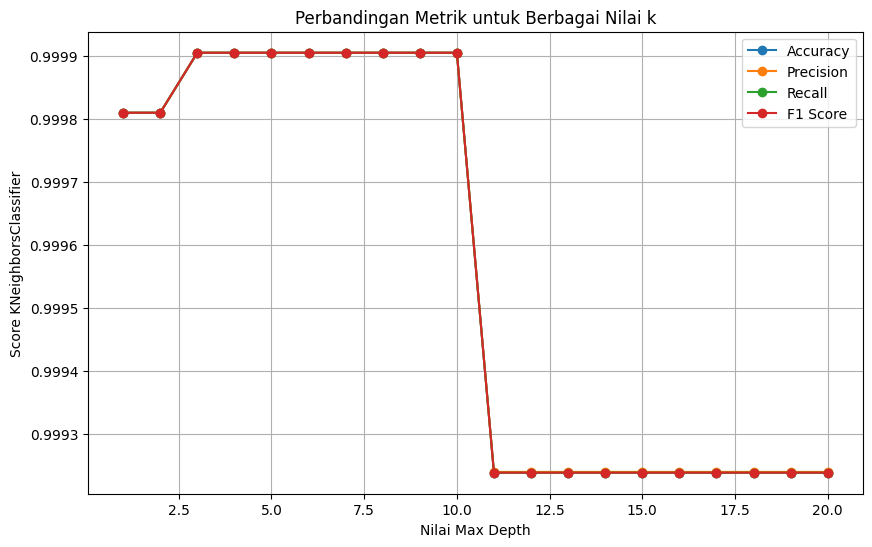

In [ ]:
plt.figure(figsize=(10, 6))
plt.plot(metrics_df['k'], metrics_df['accuracy'], marker='o', label='Accuracy')
plt.plot(metrics_df['k'], metrics_df['precision'], marker='o', label='Precision')
plt.plot(metrics_df['k'], metrics_df['recall'], marker='o', label='Recall')
plt.plot(metrics_df['k'], metrics_df['f1'], marker='o', label='F1 Score')
plt.xlabel('Nilai Max Depth')
plt.ylabel('Score KNeighborsClassifier')
plt.title('Perbandingan Metrik untuk Berbagai Nilai k')
plt.legend()
plt.grid(True)
plt.show()

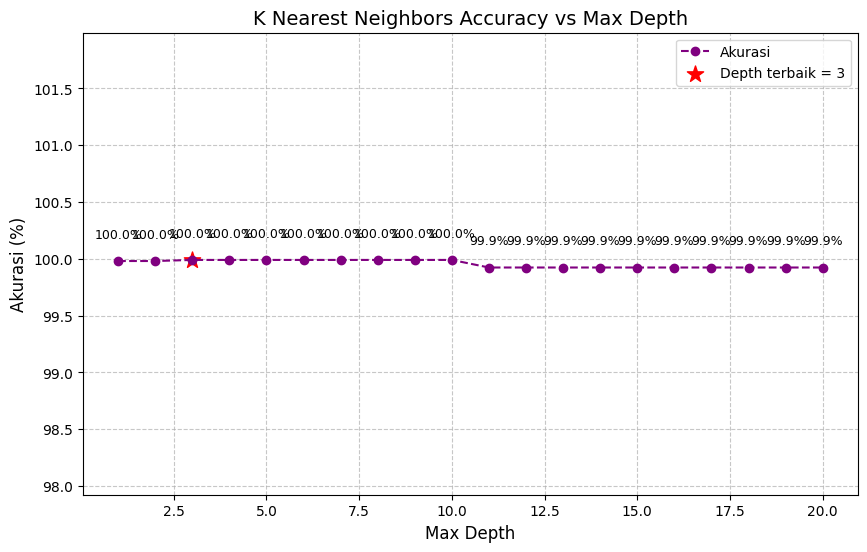

In [ ]:
depth_values = metrics_result["k"]
accuracy_values = metrics_result["accuracy"]

accuracy_percent = [acc * 100 for acc in accuracy_values]

best_idx = np.argmax(accuracy_percent)
best_depth = depth_values[best_idx]
best_acc = accuracy_percent[best_idx]

plt.figure(figsize=(10,6))
plt.plot(depth_values, accuracy_percent, marker='o', linestyle='--', color='purple', label='Akurasi')

plt.scatter(best_depth, best_acc, color='red', s=150, marker='*', label=f'Depth terbaik = {best_depth}')

for i, acc in enumerate(accuracy_percent):
    plt.text(depth_values[i], acc+0.2, f"{acc:.1f}%", ha='center', fontsize=9)

plt.title("K Nearest Neighbors Accuracy vs Max Depth", fontsize=14)
plt.xlabel("Max Depth", fontsize=12)
plt.ylabel("Akurasi (%)", fontsize=12)
plt.ylim(min(accuracy_percent)-2, max(accuracy_percent)+2)
plt.legend()
plt.grid(True, linestyle="--", alpha=0.7)
plt.show()

In [ ]:
best_max_depth = metrics_df.loc[metrics_df['f1'].idxmax(), 'k']
print(f"Best Depth Max: {best_max_depth}")

Best Depth Max: 3


In [ ]:
final_model = KNeighborsClassifier(
    n_neighbors=10, # best_max_depth
    metric='euclidean'
  )

final_model.fit(X_train, y_train)

KNeighborsClassifier(metric='euclidean', n_neighbors=10)

In [ ]:
y_pred_test = final_model.predict(X_test)

In [ ]:
print("\nClassification Report (Test Set):\n")
print(classification_report(y_test, y_pred_test))

print("")

cer = 1 - accuracy_score(y_test, y_pred_test)
print("Classification Error Rate (CER):", cer, )


Classification Report (Test Set):

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      3740
           1       1.00      1.00      1.00      3856
           2       1.00      1.00      1.00      2940

    accuracy                           1.00     10536
   macro avg       1.00      1.00      1.00     10536
weighted avg       1.00      1.00      1.00     10536


Classification Error Rate (CER): 0.00018982536066813882


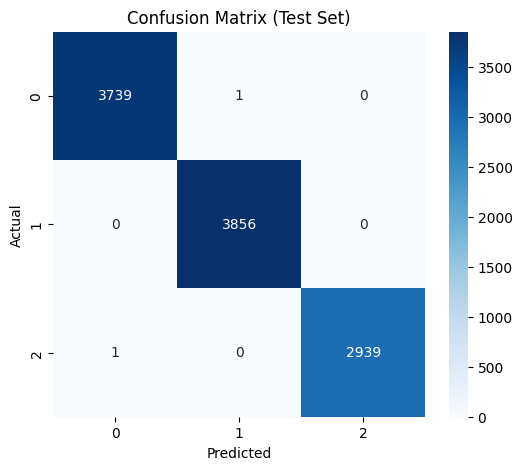

In [ ]:
cm = confusion_matrix(y_test, y_pred_test)
plt.figure(figsize=(6, 5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix (Test Set)')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

In [ ]:
def create_report(actual, prediction, matrix:bool=False, name:str="Plot"):
    print(classification_report(actual, prediction))
    if matrix:
        ConfusionMatrixDisplay(confusion_matrix(actual, prediction)).plot()
        plt.title(name)

In [ ]:
y_pred = stack.predict(X_test)

acc = accuracy_score(y_test, y_pred)
prec = precision_score(y_test, y_pred, average='weighted')
rec = recall_score(y_test, y_pred, average='weighted')
f1 = f1_score(y_test, y_pred, average='weighted')

print(f"Accuracy: {acc:.4f}")
print(f"Precision: {prec:.4f}")
print(f"Recall: {rec:.4f}")
print(f"F1-score: {f1:.4f}")

Accuracy: 1.0000
Precision: 1.0000
Recall: 1.0000
F1-score: 1.0000


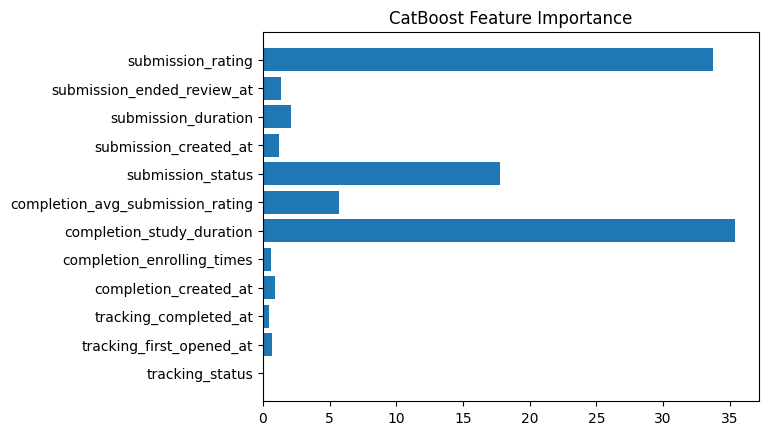

In [ ]:
cat = stack.named_estimators_['cat']
feat_importance = cat.get_feature_importance()
plt.barh(X_train.columns, feat_importance)
plt.title("CatBoost Feature Importance")
plt.show()

In [ ]:
y_train_predict = stack.predict(X_train)
y_test_predict = stack.predict(X_test)

In [ ]:
create_report(y_train, y_train_predict)

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     17524
           1       1.00      1.00      1.00     17444
           2       1.00      1.00      1.00     14225

    accuracy                           1.00     49193
   macro avg       1.00      1.00      1.00     49193
weighted avg       1.00      1.00      1.00     49193



In [ ]:
create_report(y_test, y_test_predict)

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      3740
           1       1.00      1.00      1.00      3856
           2       1.00      1.00      1.00      2940

    accuracy                           1.00     10536
   macro avg       1.00      1.00      1.00     10536
weighted avg       1.00      1.00      1.00     10536



# Explainable AI

In [ ]:
X_train_np = X_train.values
feature_names = X_train.columns.tolist()
target_names = ['label_cluster_encoding']

In [ ]:
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train_np,
    feature_names=feature_names,
    class_names=target_names,
    mode='classification', # or 'regression'
    # Optional: Specify categorical features by index
    # categorical_features=[idx1, idx2],
    # Optional: Discretize continuous features
    # discretize_continuous=True
)

In [ ]:
instance_to_explain = X_train_np[5]

In [ ]:
predict_fn = lambda x: stack.predict_proba(x)

In [ ]:
explanation = explainer.explain_instance(
    data_row=instance_to_explain,
    predict_fn=predict_fn,
    num_features=5 # Number of top features to show in explanation
)

/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but LGBMClassifier was fitted with feature names



In [ ]:
explanation.show_in_notebook(show_table=True)

In [ ]:
explanation_list = explanation.as_list()
print(explanation_list)

[('submission_rating <= 0.00', -0.8773276358877372), ('completion_study_duration > 1.41', -0.1725526096525505), ('completion_avg_submission_rating <= -1.01', -0.031063228215290322), ('submission_status <= -1.00', -0.018554618224694747), ('0.47 < submission_created_at <= 0.47', 0.011532724656477937)]
